,File Name,Color Model,Format,Channels,File Size (MB),Width,Height,Full Path,image
0,001.img.jpg,RGB,JPEG,3,2.20,5464,3640,E:\Code\Python\Khpi\Python_Laboratory_4\images\001.img.jpg,
1,002.img.jpg,RGB,JPEG,3,1.79,3543,2397,E:\Code\Python\Khpi\Python_Laboratory_4\images\002.img.jpg,
2,003.img.jpg,RGB,JPEG,3,5.71,8000,6000,E:\Code\Python\Khpi\Python_Laboratory_4\images\003.img.jpg,
3,004.img.jpg,RGB,JPEG,3,3.00,4480,6720,E:\Code\Python\Khpi\Python_Laboratory_4\images\004.img.jpg,
4,005.img.jpg,RGB,JPEG,3,1.61,4091,4091,E:\Code\Python\Khpi\Python_Laboratory_4\images\005.img.jpg,
5,007.img.jpg,RGB,JPEG,3,1.86,6255,4170,E:\Code\Python\Khpi\Python_Laboratory_4\images\007.img.jpg,
6,008.img.jpg,RGB,JPEG,3,2.91,4480,6720,E:\Code\Python\Khpi\Python_Laboratory_4\images\008.img.jpg,
7,009.img.jpg,RGB,JPEG,3,2.61,4500,6000,E:\Code\Python\Khpi\Python_Laboratory_4\images\009.img.jpg,
8,010.img.jpg,RGB,JPEG,3,1.55,4640,6960,E:\Code\Python\Khpi\Python_Laboratory_4\images\010.img.jpg,
9,011.img.jpg,RGB,JPEG,3,3.46,5120,3840,E:\Code\Python\Khpi\Python_Laboratory_4\images\011.img.jpg,

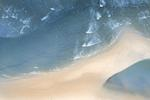
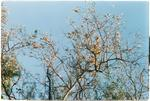
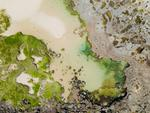
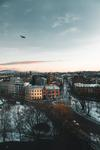
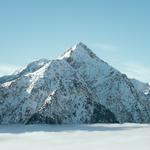
...
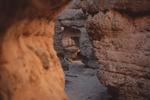
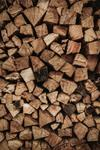
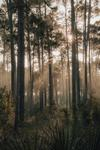
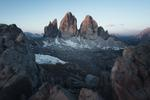
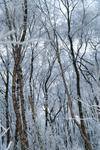

In [35]:
import pandas as pd
import base64
from io import BytesIO
from IPython.display import HTML
def get_thumbnail(path):
    i = Image.open(path)
    i.thumbnail((150, 150), Image.LANCZOS)
    return i
def image_base64(im):
    if isinstance(im, str):
        im = get_thumbnail(im)
    with BytesIO() as buffer:
        im.save(buffer, 'jpeg')
        return base64.b64encode(buffer.getvalue()).decode()
def image_formatter(im):
    return f'<img src="data:image/jpeg;base64,{image_base64(im)}">'
def get_image_info(folder_path):
    image_data = []
    for file_name in os.listdir(folder_path):
        file_path = os.path.join(folder_path, file_name)
        if os.path.isfile(file_path):
            try:
                img = Image.open(file_path)
                img_format = img.format
                img_mode = img.mode
                img_size = os.path.getsize(file_path) / (1024 * 1024)  # in megabytes
                img_size = round(img_size, 2)
                img_channels = len(img.getbands())
                img_width, img_height = img.size
                reduced_img = img.resize((100, 100))  # change the size as needed
                image_data.append({
                    'File Name': file_name,
                    'Color Model': img_mode,
                    'Format': img_format,
                    'Channels': img_channels,
                    'File Size (MB)': img_size,
                    'Width': img_width,
                    'Height': img_height,
                    'Full Path': file_path,
                    'image': get_thumbnail(file_path)
                })
            except Exception as e:
                print(f"Error processing {file_name}: {e}")
    df = pd.DataFrame(image_data)
    return df
# Example usage:
folder_path = "E:\Code\Python\Khpi\Python_Laboratory_4\images"
img_set = get_image_info(folder_path)
HTML(img_set.to_html(formatters={'image': image_formatter}, escape=False))

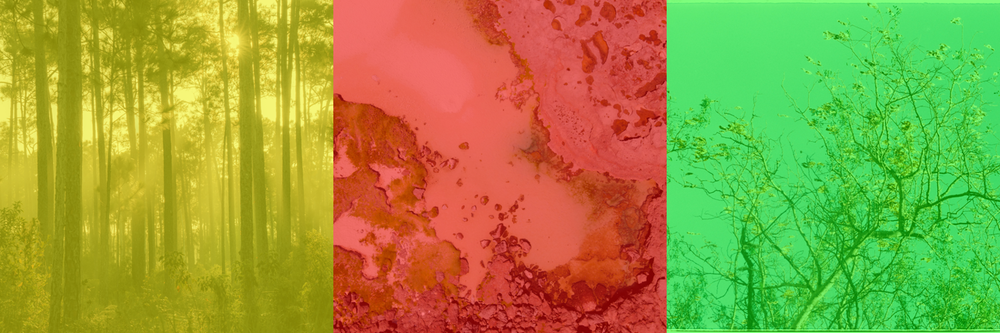

In [36]:
import os
import base64
import random
from io import BytesIO
from PIL import Image, ImageOps
def crop_and_resize(image, target_size):
    width, height = image.size
    new_size = min(width, height)
    left = (width - new_size) // 2
    top = (height - new_size) // 2
    right = (width + new_size) // 2
    bottom = (height + new_size) // 2
    cropped_image = image.crop((left, top, right, bottom))
    resized_image = cropped_image.resize((target_size, target_size))
    return resized_image
def apply_random_color_filter(image):
    filters = ['#FF0000', '#00FF00', '#0000FF', '#FFFF00', '#800080', '#00FFFF']
    selected_filter = random.choice(filters)
    colorized_image = ImageOps.colorize(image.convert("L"), selected_filter, selected_filter)
    blended_image = Image.blend(image, colorized_image.convert("RGB"), alpha=0.5)
    return blended_image
def create_poster(folder_path, output_name, columns, rows):
    images = []
    image_files = [file for file in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, file))]
    if not image_files:
        print(f"No image files found in the folder: {folder_path}")
        return
    for _ in range(columns * rows):
        random_image_path = random.choice(image_files)
        image_path = os.path.join(folder_path, random_image_path)
        while  not image_path.lower().endswith(('.png', '.jpg', '.jpeg')):
            random_image_path = random.choice(image_files)
            image_path = os.path.join(folder_path, random_image_path)  
        try:
            image = Image.open(image_path)
            image = crop_and_resize(image, 533)
            image = image.resize((500, 500))
            image = apply_random_color_filter(image)  
            images.append(image)
        except Exception as e:
            print(f"Error processing {random_image_path}: {e}")
            continue
    total_images = len(images)
    required_images = columns * rows
    if total_images < required_images:
        print(f"Not enough images to create the poster. Expected {required_images}, found {total_images}.")
        return
    # Create the poster
    poster = Image.new('RGB', (columns * 500, rows * 500))
    for i in range(rows):
        for j in range(columns):
            index = i * columns + j
            poster.paste(images[index], (j * 500, i * 500))
    # Save the poster
    poster.save(output_name + '.png')
    return poster
# Example usage:
folder_path = "./images"
create_poster(folder_path, 'poster1', 3, 1)

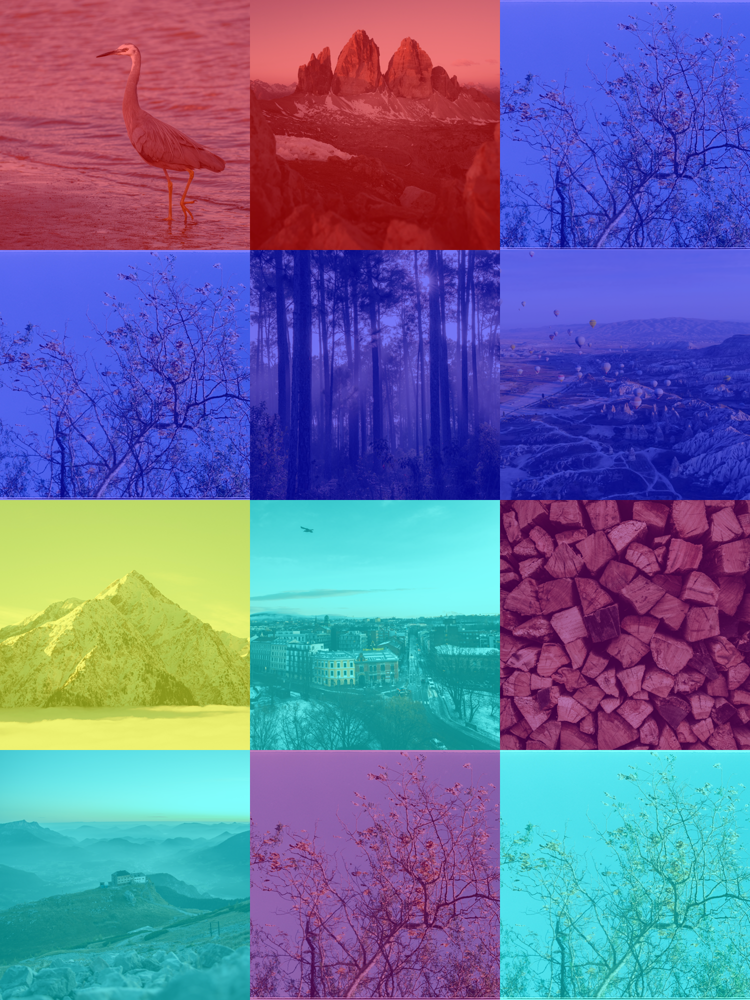

In [37]:
create_poster(folder_path, 'poster2', 3, 4)

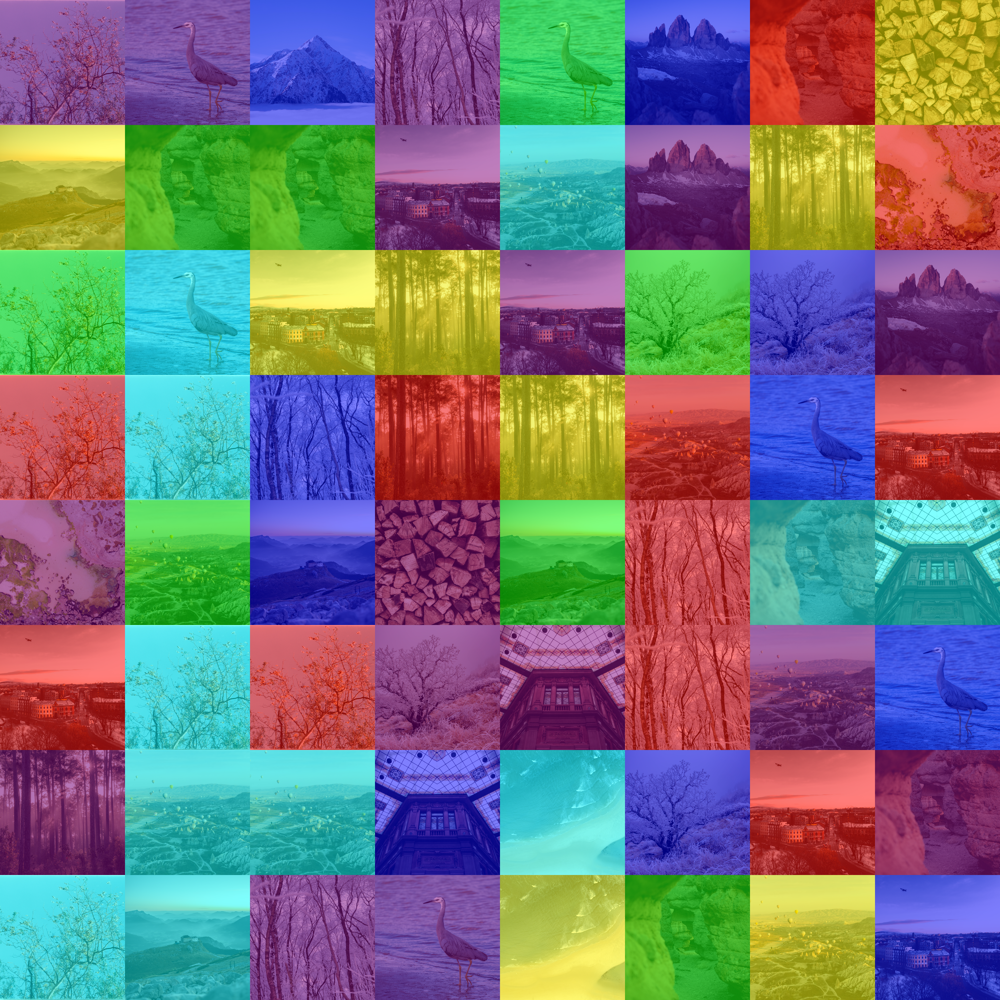

In [38]:
create_poster(folder_path, 'poster3', 8, 8)